# 🍄 Mushrooms!

In this notebook I'll try to learn which features spell certain death and which contribute to a great taste among different types of mushrooms.

# 1. Data
This dataset from [Kaggle](https://www.kaggle.com/uciml/mushroom-classification) includes data regarding 23 species of gilled mushrooms in the Agaricus and Lepiota Family Mushroom drawn from The Audubon Society Field Guide to North American Mushrooms (1981).  
Each species is identified as definitely edible, definitely poisonous, or of unknown edibility and not recommended. This latter class was combined with the poisonous one. 

The Guide clearly states that 
> there is no simple rule for determining the edibility of a mushroom

But can our model figure some patterns out?

# 2. Evaluation

Since this is a **binary classification** problem, I'll use four different metrics:
* `precision`
* `accuracy`
* `f1 score`
* `recall`

focusing primarly on `accuracy`.

# 3. Feature exploration

We have 23 different features:

* `cap-shape`: bell=b, conical=c, convex=x, flat=f, knobbed=k, sunken=s
* `cap-surface`: fibrous=f, grooves=g, scaly=y, smooth=s
* `cap-color`: brown=n, buff=b, cinnamon=c, gray=g, green=r, pink=p, purple=u, red=e, white=w, yellow=y
* `bruises`: bruises=t, no=f
* `odor`: almond=a, anise=l, creosote=c, fishy=y, foul=f, musty=m, none=n, pungent=p, spicy=s
* `gill-attachment`: attached=a, descending=d, free=f, notched=n
* `gill-spacing`: close=c, crowded=w, distant=d
* `gill-size`: broad=b, narrow=n
* `gill-color`: black=k, brown=n, buff=b, chocolate=h, gray=g, green=r, orange=o, pink=p, purple=u, red=e, white=w, yellow=y
* `stalk-shape`: enlarging=e, tapering=t
* `stalk-root`: bulbous=b, club=c, cup=u, equal=e, rhizomorphs=z, rooted=r, missing=?
* `stalk-surface-above-ring`: fibrous=f, scaly=y, silky=k, smooth=s
* `stalk-surface-below-ring`: fibrous=f, scaly=y, silky=k, smooth=s
* `stalk-color-above-ring`: brown=n, buff=b, cinnamon=c, gray=g, orange=o, pink=p, red=e, white=w, yellow=y
* `stalk-color-below-ring`: brown=n, buff=b, cinnamon=c, gray=g, orange=o, pink=p, red=e, white=w, yellow=y
* `veil-type`: partial=p, universal=u
* `veil-color`: brown=n, orange=o, white=w, yellow=y
* `ring-number`: none=n, one=o, two=t
* `ring-type`: cobwebby=c, evanescent=e, flaring=f, large=l, none=n, pendant=p, sheathing=s, zone=z
* `spore-print-color`: black=k, brown=n, buff=b, chocolate=h, green=r, orange=o, purple=u, white=w, yellow=y
* `population`: abundant=a, clustered=c, numerous=n, scattered=s, several=v, solitary=y
* `habitat`: grasses=g, leaves=l, meadows=m, paths=p, urban=u, waste=w, woods=d

Our target is `classes`: edible=e, poisonous=p


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb

seed = 78145

In [2]:
df = pd.read_csv("./data/mushrooms.csv")
df.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,p,x,s,n,t,p,f,c,n,k,...,s,w,w,p,w,o,p,k,s,u
1,e,x,s,y,t,a,f,c,b,k,...,s,w,w,p,w,o,p,n,n,g
2,e,b,s,w,t,l,f,c,b,n,...,s,w,w,p,w,o,p,n,n,m
3,p,x,y,w,t,p,f,c,n,n,...,s,w,w,p,w,o,p,k,s,u
4,e,x,s,g,f,n,f,w,b,k,...,s,w,w,p,w,o,e,n,a,g


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8124 entries, 0 to 8123
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   class                     8124 non-null   object
 1   cap-shape                 8124 non-null   object
 2   cap-surface               8124 non-null   object
 3   cap-color                 8124 non-null   object
 4   bruises                   8124 non-null   object
 5   odor                      8124 non-null   object
 6   gill-attachment           8124 non-null   object
 7   gill-spacing              8124 non-null   object
 8   gill-size                 8124 non-null   object
 9   gill-color                8124 non-null   object
 10  stalk-shape               8124 non-null   object
 11  stalk-root                8124 non-null   object
 12  stalk-surface-above-ring  8124 non-null   object
 13  stalk-surface-below-ring  8124 non-null   object
 14  stalk-color-above-ring  

All of our data is in `object` format, but we can clearly see that they are all `string`.  
More specifically, they are letters and each letter represents a possible class for that specific feature.  

*Is it bad?*  
No*, but since the letters aren't very communicative, it would be nice to have a helper object that has the following methods:
* gets a feature value (a letter) and it returns the entire string that describes the value
    - Example: we pass `"b"` for feature `cap-shape` and it returns `"bell"`
* gets a feature key and returns all the possible values
    - Example: we pass `cap-shape` and it returns `bell=b, conical=c, convex=x, flat=f, knobbed=k, sunken=s`


*: later we will have to encode all these features into numbers (will be much easier done than said, for once 😄)

In [4]:
from helpers.mushroom_features import MushroomFeatures

MushroomFeatures.valuename_of(feature='cap-shape', letter='b')

'bell'

This helper class will become useful later on. Now let's focus on some feature exploration.  
Let's start by looking at how features are correlated to each other.

## Feature encoding

We need to have data in numeric format in order to explore the correlation matrix.

In [5]:
from sklearn.preprocessing import OrdinalEncoder

enc = OrdinalEncoder()
dft = enc.fit_transform(df)
dft = pd.DataFrame(dft, columns=df.columns)

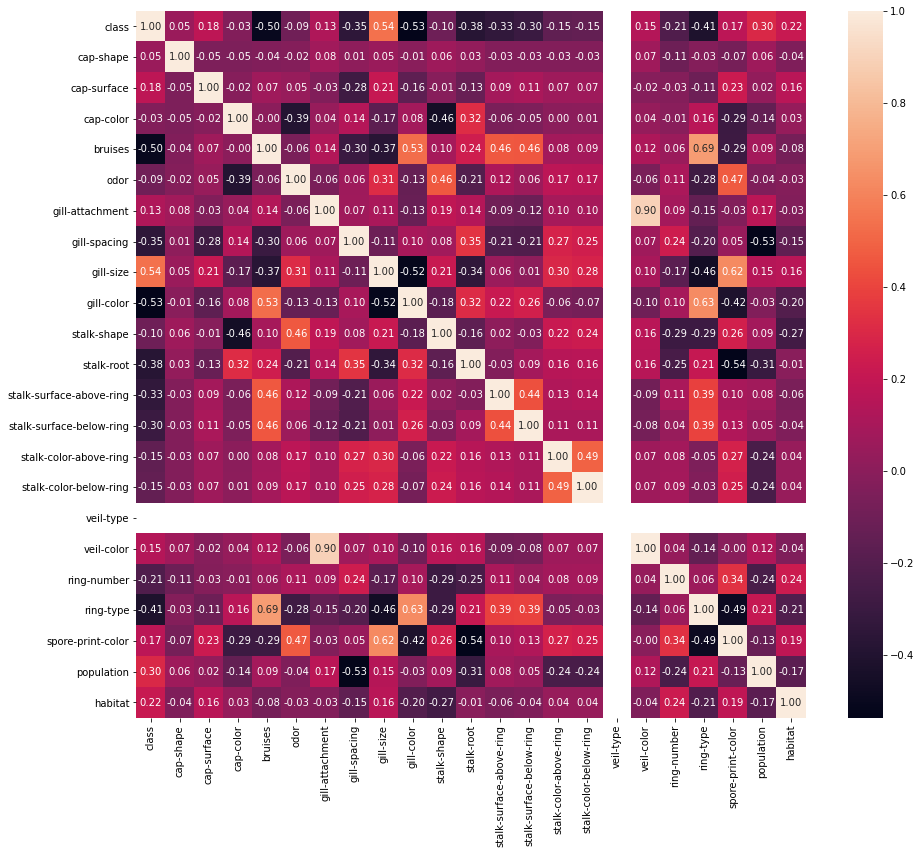

In [6]:
def plot_heatmap(dataframe):
    corr_mat = dataframe.corr()

    fig, ax = plt.subplots(figsize=(15,13))
    ax = sb.heatmap(corr_mat, annot=True, fmt='.2f')

plot_heatmap(dft)

What's up with `veil-type`?

In [7]:
dft['veil-type'].value_counts()

0.0    8124
Name: veil-type, dtype: int64

Alright, that's why. All the values are the same. Let's `drop()` that column then.

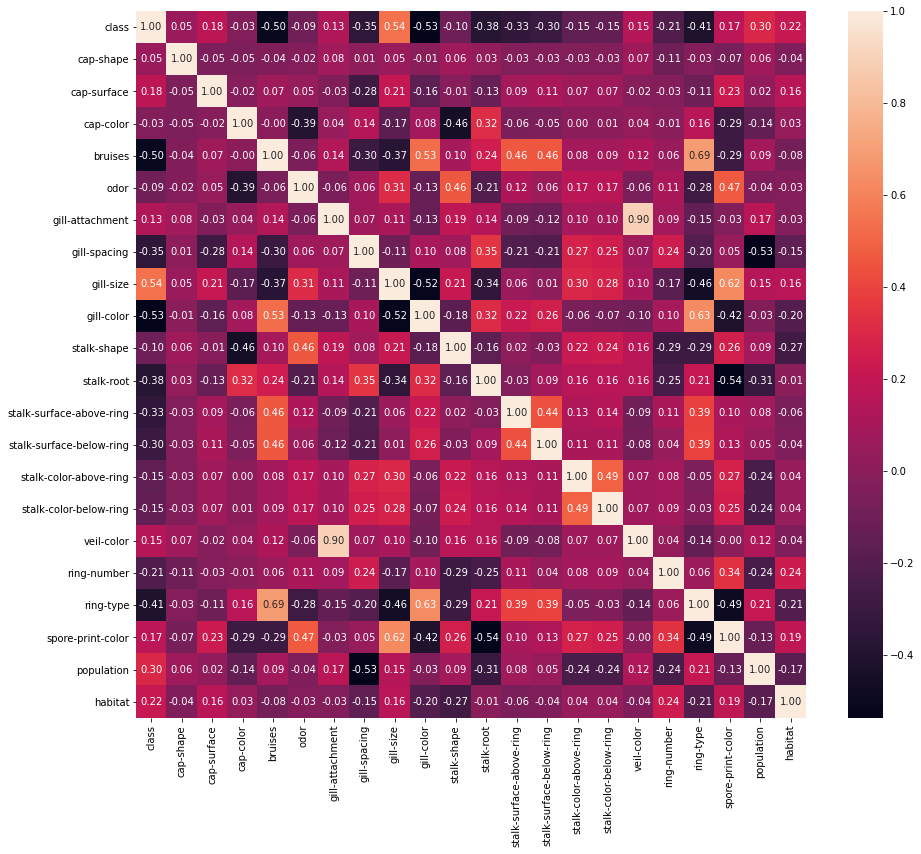

In [8]:
plot_heatmap(dft.drop('veil-type', axis=1))

There are few interesting relations, namely:
* `veil-color` vs `gill-attachment`
* `ring-type` vs `bruises`
* `ring-type` vs `gill-color`
* `gill-color` vs `bruises`

Among others, there are also some relations regarding our target variable:
* `class` vs `gill-size`
* `class` vs `gill-color`
* `class` vs `bruises`

We'll see if they'll prove to be important features in determining a mushroom's class.

We can see that only a subset of features seem to be highly correlated to each other.  
Since `veil-color` and `gill-attachment` are only highly correlated between themselves, I'll plot them separately.  
For the other features, instead of manually checking every single pair, we'll use `seaborn.pairplot`

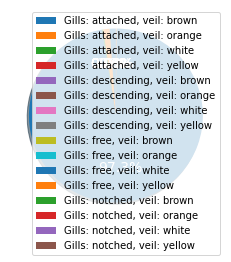

In [25]:
sizes = []
labels = []

for g in MushroomFeatures.values_short('gill-attachment'):
    for v in MushroomFeatures.values_short('veil-color'):
        cond1 = df['gill-attachment'] == g
        cond2 = df['veil-color'] == v

        sizes.append(len(df.where(cond1 & cond2).dropna()) / len(df))

        gill_extended = MushroomFeatures.valuename_of('gill-attachment', g)
        veil_extended = MushroomFeatures.valuename_of('veil-color', v)
        labels.append(f"Gills: {gill_extended}, veil: {veil_extended}")

plt.pie(sizes,
        shadow=True,
        startangle=90,
        autopct='%1.1f%%',
        textprops={'color': 'white', 'fontsize': 14}
)
plt.legend(labels)

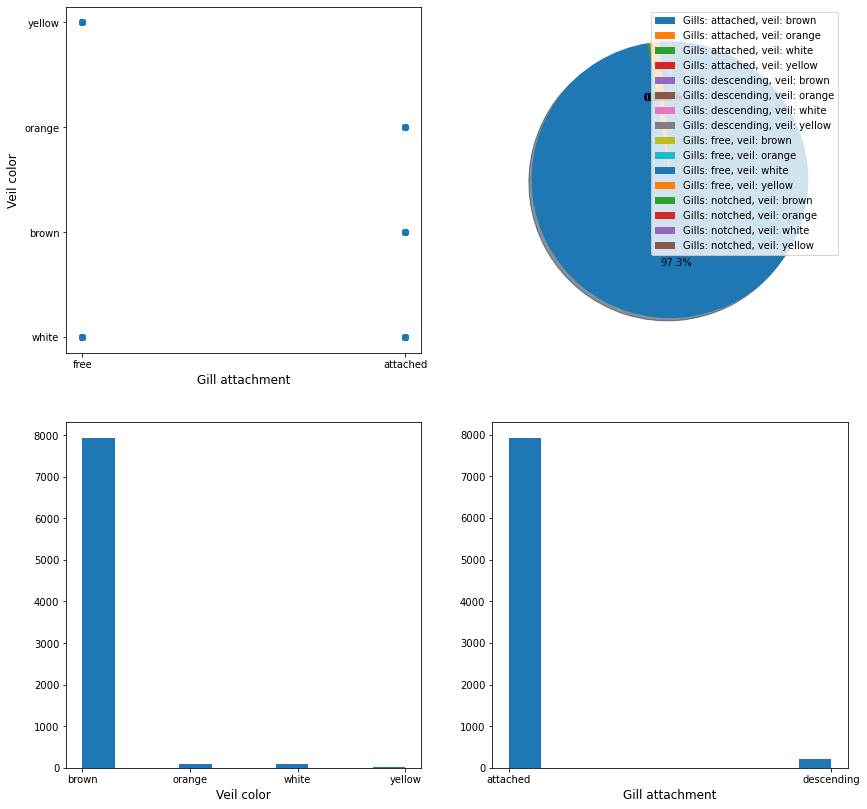

In [32]:
def plot_gill_vs_veil():
    fig, ax = plt.subplots(
        ncols=2,
        nrows=2,
        figsize=(14,14)
    )

    fontsize = {'fontsize': 12}

    # scatter plot
    yticks_lab = [MushroomFeatures.valuename_of('veil-color', lett) for lett in ['w', 'n', 'o', 'y']]
    xticks_lab = [MushroomFeatures.valuename_of('gill-attachment', lett) for lett in ['f', 'a']]
    ax[0,0].scatter(df['gill-attachment'], df['veil-color'])

    ax[0,0].set_xlabel('Gill attachment', **fontsize)
    ax[0,0].set_ylabel('Veil color', **fontsize)
    ax[0,0].set_xticklabels(xticks_lab)
    ax[0,0].set_yticklabels(yticks_lab)

    # pie plot
    sizes = []
    labels = []

    for g in MushroomFeatures.values_short('gill-attachment'):
        for v in MushroomFeatures.values_short('veil-color'):
            cond1 = df['gill-attachment'] == g
            cond2 = df['veil-color'] == v

            # proportion of this combination compared to the entire df
            size = len(df.where(cond1 & cond2).dropna()) / len(df)
            sizes.append(size)

            # create a readable label for the current combination
            gill_extended = MushroomFeatures.valuename_of('gill-attachment', g)
            veil_extended = MushroomFeatures.valuename_of('veil-color', v)
            labels.append(f"Gills: {gill_extended}, veil: {veil_extended}")

    ax[0,1].pie(sizes,
        shadow=True,
        startangle=90,
        autopct='%1.1f%%'
    )
    ax[0,1].legend(labels, loc='upper right', frameon=True)

    # veil hist
    ax[1,0].hist(df['veil-color'])

    xticks_lab = [MushroomFeatures.valuename_of('veil-color', lett) for lett in MushroomFeatures.values_short('veil-color')]
    ax[1,0].set_xticklabels(xticks_lab)
    ax[1,0].set_xlabel('Veil color', **fontsize)

    # gill hist
    ax[1,1].hist(df['gill-attachment'])

    xticks_lab = [MushroomFeatures.valuename_of('gill-attachment', lett) for lett in MushroomFeatures.values_short('gill-attachment')]
    ax[1,1].set_xticklabels(xticks_lab)
    ax[1,1].set_xlabel('Gill attachment', **fontsize)

plot_gill_vs_veil()

In [11]:
cond = df['veil-color'] == 'w'
cond2 = df['gill-attachment'] == 'y'
len(df.where(cond & cond2).dropna())

0

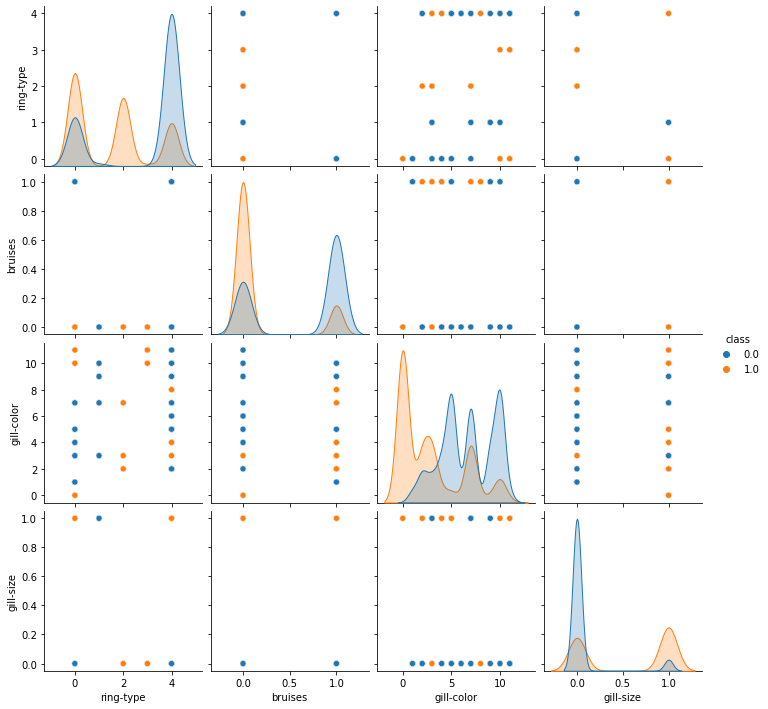

In [12]:
interesting_features = ['ring-type', 'bruises', 'gill-color', 'class', 'gill-size']
sb.pairplot(dft[interesting_features], hue='class')